<< [Índice](./intro.html)

# **Introducción a la optimización por enjambre de partículas**

La optimización por enjambre de partículas, también conocida como PSO por sus siglas en inglés (Particle Swarm Otimization) es un método de optimización basada en la imitación del comportamiento de las bandadas de pájaros y los bancos de peces. Como lo dicen sus creadores, Kennedy & Eberhart, es un método  que busca la optimización de funciones no lienales continuas (1995, p.1). Con esto, podemos inferir que las funciones a optimizar no tienen que ser diferenciables necesariamente, de esta forma abarcando un rango muy amplio de funciones.

In [ ]:
!pip install pyswarms

In [ ]:
# Import modules
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import animation, rc
from IPython.display import HTML

# Import PySwarms
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import (plot_cost_history, plot_contour, plot_surface)



In [ ]:
def rosenbrock_2d(x):

    f = (1 - (x[:, 0])) ** 2 + 100 * ((x[:, 1]) - (x[:, 0]) ** 2) ** 2
    return f

In [ ]:
from pyswarms.single.global_best import GlobalBestPSO

# instantiate the optimizer
x_max = 10 * np.ones(2)
x_min = -1 * x_max
bounds = (x_min, x_max)
options = {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
optimizer = GlobalBestPSO(n_particles=10, dimensions=2, options=options, bounds=bounds)

# now run the optimization, pass a=1 and b=100 as a tuple assigned to args

cost, pos = optimizer.optimize(rosenbrock_2d, 200)


2024-03-12 13:35:35,136 - pyswarms.single.global_best - INFO - Optimize for 200 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|200/200, best_cost=6.08e-8
2024-03-12 13:35:35,225 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 6.082745316759261e-08, best pos: [1.00022939 1.00044977]


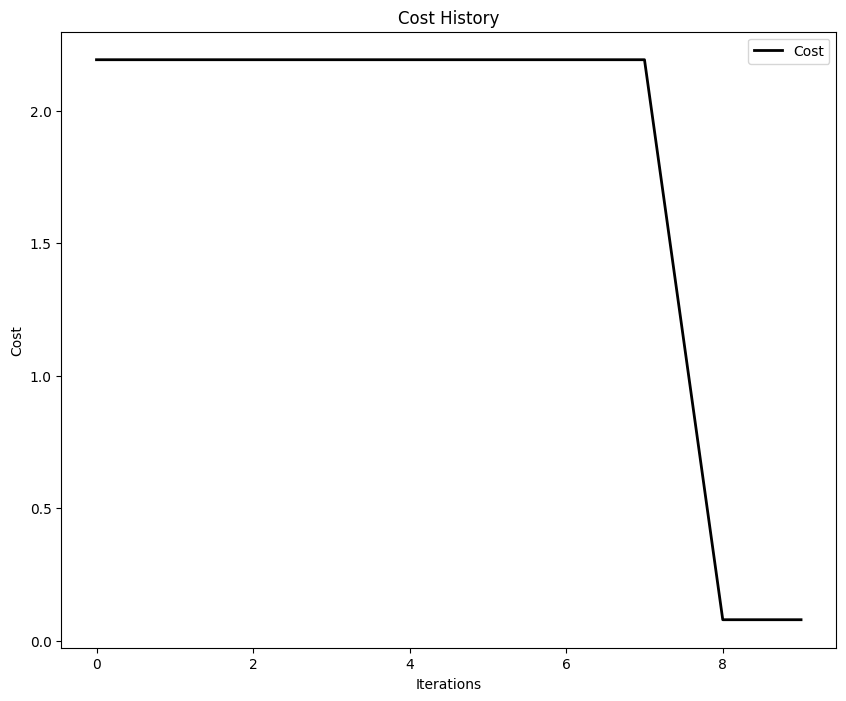

In [ ]:
plot_cost_history(cost_history=optimizer.cost_history)
plt.show()

In [ ]:
def rosenbrock_function_2d(x1, x2):
    return (1 - x1)**2 + 100 * (x2 - x1**2)**2


In [ ]:

import matplotlib.pyplot as plt
import imageio
import random
from IPython.display import Video
from moviepy.editor import VideoFileClip

def create_plot_2d():
    # Seteo los ejes sobre los que voy a trabajar
    plt.xlim(-2, 2)
    plt.ylim(-2, 2)

    # Generamos la nube de puntos sobre la que se generarán las curvas de nivel
    x = np.linspace(-2, 2, 100)
    y = np.linspace(-2, 2, 100)
    x, y = np.meshgrid(x, y)
    z = rosenbrock_function_2d(x, y)

    # Generamos las curva de nivel de la función
    plt.contour(x, y, z, levels=100, cmap='viridis')

    # Etiquetas de los ejes
    plt.xlabel('$x_{1} \;  \in \; \mathbb{R}$')
    plt.ylabel('$x_{2} \;  \in \; \mathbb{R}$')

    # Solucion real
    plt.scatter(1, 1, color='blue', label='(1, 1)')


    # Mostrar el gráfico
    plt.colorbar(label='Niveles en  $z \; \in \mathbb{R}$')
    plt.title(f'Mejor solucion del grupo {1} (punto azul solución real)')
    plt.grid(True)

In [ ]:


# History of best positions
pos_history = optimizer.pos_history

create_plot_2d()

images = []
# Colors to plot points that are the best solution of each generation so that if points overlap the change is seen
colors = ['red', 'yellow', 'green', 'orange', 'pink']

for group  in range(0, len(pos_history)):

    current_group = pos_history[group]

    for position in range(0,len(current_group)):
        # Se geeneran las etiquetas de cada frame del video y su respectiva generación
        plt.title(f'Mejor solucion del grupo {group+1} (punto azul solución real)')

        # Graficar la mejor solución de cada generación
        plt.scatter(current_group[position][0], current_group[position][1], color = colors[random.randint(0, 4)])

        # Se guarda cada frame como imagen para luego usar las imagenes guardadas para generar el video

    plt.savefig('media'+'/'+f'generation_{group}.png')

        # Se agrega la imagen a la lista de imagenes para luego generar el gif
    images.append(imageio.imread('media'+'/'+f'generation_{group}.png'))
    plt.clf()
    # Seteo los ejes sobre los que voy a trabajar
    create_plot_2d()




# Se genera el gif a partir de la lista de imagenes y se guarda en el sistema de archivos
imageio.mimsave('media'+'/'+'rosenbrock_contour.gif', images, fps=1000)

# Para no mostrar la figura actual aún
plt.close()



gif_path = 'media'+'/'+'rosenbrock_contour.gif'

# Convertir GIF a video
clip = VideoFileClip(gif_path)
video_path = 'media'+'/'+'output.mp4'
clip.write_videofile(video_path, fps=1000, logger=None)

# Mostrar el video
Video(video_path, embed=True)


2024-03-12 13:36:22,010 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 13:36:22,042 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 13:36:22,074 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 13:36:22,162 - py.warnings - WARNING - /var/folders/6g/tjnfv5wj64v0x52560_65xvcsz_6nv/T/ipykernel_32910/3996698340.py:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread('media'+'/'+f'generation_{group}.png'))



Ahora haremos el mismo ejercicio pero con la función en 3 dimensiones

In [ ]:
def rosenbrock_3d(x):

    f = (1 - (x[:, 0])) ** 2 + 100 * ((x[:, 1]) - (x[:, 0]) ** 2) ** 2 + (1-(x[:, 1])**2)**2 + 100 * ( (x[:, 2])- (x[:, 1])**2)**2
    return f

In [ ]:
# instantiate the optimizer
x_max = 10 * np.ones(3)
x_min = -1 * x_max
bounds = (x_min, x_max)
options = {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
optimizer = GlobalBestPSO(n_particles=10, dimensions=3, options=options, bounds=bounds)

# now run the optimization, pass a=1 and b=100 as a tuple assigned to args

cost, pos = optimizer.optimize(rosenbrock_3d, 250)

2024-03-12 14:25:44,356 - pyswarms.single.global_best - INFO - Optimize for 250 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|250/250, best_cost=0.0176
2024-03-12 14:25:44,527 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.017612407980714378, best pos: [0.96873371 0.94569186 0.89580832]


Graficaremos las curvas de nivel de la función con respecto X1,X3

In [ ]:
# Función de rosenbrock en con respecto a x,z

def rosenbrock_3_dim_x_z(x, z):
    return ((1 - x)**2 + 100 * (0 - x**2)**2) + ((1 - 0**2)**2 + 100 * (z - 0**2)**2)

    # Función de rosenbrock en con respecto a y,z
def rosenbrock_3_dim_y_z(y,z):
    return ((1 - 0)**2 + 100 * (y - 0**2)**2) + ((1 - y**2)**2 + 100 * (z - y**2)**2)

In [ ]:
def create_plot_3d_x_z():
    # Seteo los ejes sobre los que voy a trabajar
    plt.xlim(-2, 2)
    plt.ylim(-2, 2)

    # Generamos la nube de puntos sobre la que se generarán las curvas de nivel
    x = np.linspace(-2, 2, 100)
    z = np.linspace(-2, 2, 100)
    x, z = np.meshgrid(x, z)
    w = rosenbrock_3_dim_x_z(x, z)

    # Generamos las curva de nivel de la función
    plt.contour(x, z, w, levels=100, cmap='viridis')

    # Etiquetas de los ejes
    plt.xlabel('$x_{1} \;  \in \; \mathbb{R}$')
    plt.ylabel('$x_{3} \;  \in \; \mathbb{R}$')

    # Solucion real
    plt.scatter(1, 1, color='blue', label='(1, 1)')


    # Mostrar el gráfico
    plt.colorbar(label='Niveles en  $z \; \in \mathbb{R}$')
    plt.title(f'Mejor solucion del grupo {1} (punto azul solución real)')
    plt.grid(True)

In [ ]:


# History of best positions
pos_history = optimizer.pos_history

create_plot_3d_x_z()

images = []
# Colors to plot points that are the best solution of each generation so that if points overlap the change is seen
colors = ['red', 'yellow', 'green', 'orange', 'pink']

for group  in range(0, len(pos_history)):

    current_group = pos_history[group]

    for position in range(0,len(current_group)):
        # Se geeneran las etiquetas de cada frame del video y su respectiva generación
        plt.title(f'Mejor solucion del grupo {group+1} (punto azul solución real)')

        # Graficar la mejor solución de cada generación
        plt.scatter(current_group[position][0], current_group[position][1], color = colors[random.randint(0, 4)])

        # Se guarda cada frame como imagen para luego usar las imagenes guardadas para generar el video

    plt.savefig('media'+'/'+f'generation_{group}.png')

        # Se agrega la imagen a la lista de imagenes para luego generar el gif
    images.append(imageio.imread('media'+'/'+f'generation_{group}.png'))
    plt.clf()
    # Seteo los ejes sobre los que voy a trabajar
    create_plot_3d_x_z()




# Se genera el gif a partir de la lista de imagenes y se guarda en el sistema de archivos
imageio.mimsave('media'+'/'+'rosenbrock_contour.gif', images, fps=1000)

# Para no mostrar la figura actual aún
plt.close()



gif_path = 'media'+'/'+'rosenbrock_contour.gif'

# Convertir GIF a video
clip = VideoFileClip(gif_path)
video_path = 'media'+'/'+'output.mp4'
clip.write_videofile(video_path, fps=1000, logger=None)

# Mostrar el video
Video(video_path, embed=True)


2024-03-12 14:25:50,363 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral


2024-03-12 14:25:50,423 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 14:25:50,457 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 14:25:50,569 - py.warnings - WARNING - /var/folders/6g/tjnfv5wj64v0x52560_65xvcsz_6nv/T/ipykernel_32910/2317913914.py:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread('media'+'/'+f'generation_{group}.png'))



Graficaremos las curvas de nivel de la función con respecto X2,X3

In [ ]:
def create_plot_3d_y_z():
    # Seteo los ejes sobre los que voy a trabajar
    plt.xlim(-2, 2)
    plt.ylim(-2, 2)

    # Generamos la nube de puntos sobre la que se generarán las curvas de nivel
    y = np.linspace(-2, 2, 100)
    z = np.linspace(-2, 2, 100)
    y, z = np.meshgrid(y, z)
    w = rosenbrock_3_dim_y_z(y, z)

    # Generamos las curva de nivel de la función
    plt.contour(y, z, w, levels=100, cmap='viridis')

    # Etiquetas de los ejes
    plt.xlabel('$x_{1} \;  \in \; \mathbb{R}$')
    plt.ylabel('$x_{3} \;  \in \; \mathbb{R}$')

    # Solucion real
    plt.scatter(1, 1, color='blue', label='(1, 1)')


    # Mostrar el gráfico
    plt.colorbar(label='Niveles en  $z \; \in \mathbb{R}$')
    plt.title(f'Mejor solucion del grupo {1} (punto azul solución real)')
    plt.grid(True)

In [ ]:


# History of best positions
pos_history = optimizer.pos_history

create_plot_3d_y_z()

images = []
# Colors to plot points that are the best solution of each generation so that if points overlap the change is seen
colors = ['red', 'yellow', 'green', 'orange', 'pink']

for group  in range(0, len(pos_history)):

    current_group = pos_history[group]

    for position in range(0,len(current_group)):
        # Se geeneran las etiquetas de cada frame del video y su respectiva generación
        plt.title(f'Mejor solucion del grupo {group+1} (punto azul solución real)')

        # Graficar la mejor solución de cada generación
        plt.scatter(current_group[position][0], current_group[position][1], color = colors[random.randint(0, 4)])

        # Se guarda cada frame como imagen para luego usar las imagenes guardadas para generar el video

    plt.savefig('media'+'/'+f'generation_{group}.png')

        # Se agrega la imagen a la lista de imagenes para luego generar el gif
    images.append(imageio.imread('media'+'/'+f'generation_{group}.png'))
    plt.clf()
    # Seteo los ejes sobre los que voy a trabajar
    create_plot_3d_y_z()




# Se genera el gif a partir de la lista de imagenes y se guarda en el sistema de archivos
imageio.mimsave('media'+'/'+'rosenbrock_contour.gif', images, fps=1000)

# Para no mostrar la figura actual aún
plt.close()



gif_path = 'media'+'/'+'rosenbrock_contour.gif'

# Convertir GIF a video
clip = VideoFileClip(gif_path)
video_path = 'media'+'/'+'output.mp4'
clip.write_videofile(video_path, fps=1000, logger=None)

# Mostrar el video
Video(video_path, embed=True)


2024-03-12 14:26:52,440 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 14:26:52,519 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 14:26:52,550 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-12 14:26:52,690 - py.warnings - WARNING - /var/folders/6g/tjnfv5wj64v0x52560_65xvcsz_6nv/T/ipykernel_32910/4241587697.py:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread('media'+'/'+f'generation_{group}.png'))



Ahora puedes volver al índice y seguir explorando el contenido:

<< [Índice](./intro.html)